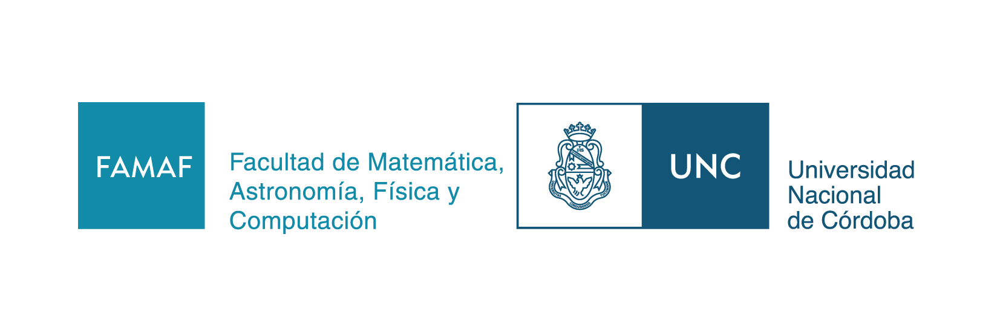
#Optativa Series de Tiempo 2025


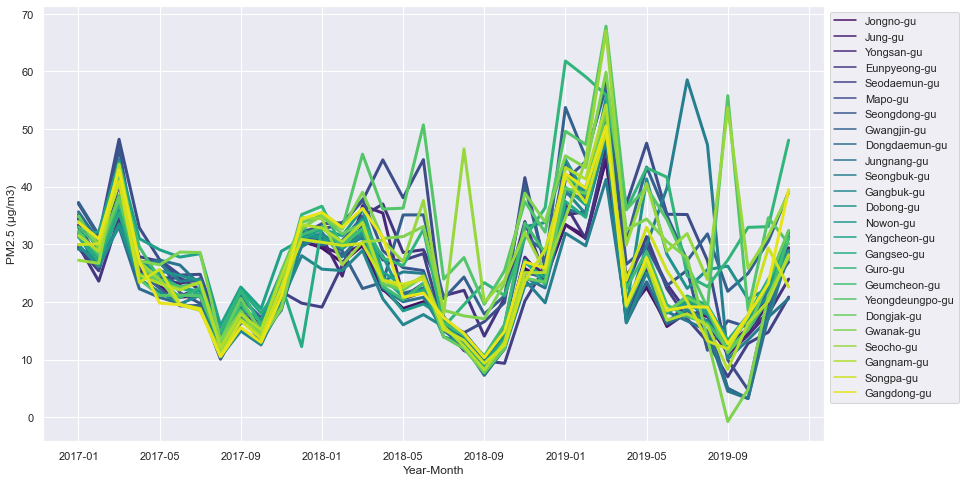

#Exploración de datos de polución con Python

In [16]:


import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory



# Propósito

Para trabajar con un ejemplo de caso real, usaré el conjunto de datos Air Pollution in Seoul de Kaggle (enlace). Los datos fueron proporcionados por el Gobierno Metropolitano de Seúl. Se trata de información sobre la contaminación del aire que consiste en SO2, NO2, CO, O3, PM10 y PM2.5 entre 2017 y 2019 de 25 distritos en Seúl, la capital de Corea del Sur.

En este ejercicio, se plotean las series de los contaminantes, y se realiza curación de datos atípicos.


## Importando los datos y librerias  

In [17]:
# Standard packages
import json

# Libs to deal with tabular data
import numpy as np
import pandas as pd
import pip
pd.options.mode.chained_assignment = None
pip.main(['install', 'geopandas'])
import geopandas as gpd

# Plotting packages
import seaborn as sns
import matplotlib.pyplot as plt

# Lib to create maps
pip.main(['install', 'folium'])
import folium

from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

# To display stuff in notebook
from IPython.display import display, Markdown

Please see https://github.com/pypa/pip/issues/5599 for advice on fixing the underlying issue.
To avoid this problem you can invoke Python with '-m pip' instead of running pip directly.


Requirement already satisfied: geopandas in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (1.1.1)

Requirement already satisfied: numpy>=1.24 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from geopandas) (2.3.1)

Requirement already satisfied: pyogrio>=0.7.2 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from geopandas) (0.11.1)

Requirement already satisfied: packaging in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from geopandas) (25.0)

Requirement already satisfied: pandas>=2.0.0 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from geopandas) (2.3.0)

Requirement already satisfied: pyproj>=3.5.0 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from geopandas) (3.7.2)

Requirement already satisfied: shapely>=2.0.0 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from geopandas) (2.1.2)

Requirement already satisfied: python-dateutil>=2.8.2 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from pandas>=2.0.0->geopandas) (2.9.0.post0)

Requirement already satisfied: pytz>=2020.1 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from pandas>=2.0.0->geopandas) (2025.2)

Requirement already satisfied: tzdata>=2022.7 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from pandas>=2.0.0->geopandas) (2025.2)

Requirement already satisfied: certifi in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from pyogrio>=0.7.2->geopandas) (2025.7.14)

Requirement already satisfied: six>=1.5 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from python-dateutil>=2.8.2->pandas>=2.0.0->geopandas) (1.17.0)

[notice] A new release of pip is available: 25.1.1 -> 25.3
[notice] To update, run: C:\Users\Santiago Castellanos\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip

Please see https://github.com/pypa/pip/issues/5599 for advice on fixing the underlying issue.
To avoid this problem you can invoke Python with '-m pip' instead of running pip directly.


Requirement already satisfied: folium in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (0.20.0)

Requirement already satisfied: branca>=0.6.0 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from folium) (0.8.2)

Requirement already satisfied: jinja2>=2.9 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from folium) (3.1.6)

Requirement already satisfied: numpy in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from folium) (2.3.1)

Requirement already satisfied: requests in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from folium) (2.32.4)

Requirement already satisfied: xyzservices in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from folium) (2025.10.0)

Requirement already satisfied: MarkupSafe>=2.0 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from jinja2>=2.9->folium) (3.0.3)

Requirement already satisfied: charset_normalizer<4,>=2 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from requests->folium) (3.4.2)

Requirement already satisfied: idna<4,>=2.5 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from requests->folium) (3.10)

Requirement already satisfied: urllib3<3,>=1.21.1 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from requests->folium) (2.5.0)

Requirement already satisfied: certifi>=2017.4.17 in c:\users\santiago castellanos\appdata\local\packages\pythonsoftwarefoundation.python.3.11_qbz5n2kfra8p0\localcache\local-packages\python311\site-packages (from requests->folium) (2025.7.14)

[notice] A new release of pip is available: 25.1.1 -> 25.3
[notice] To update, run: C:\Users\Santiago Castellanos\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


Como se puede ver en la descripción del conjunto de datos, se proporcionan cuatro archivos.

- `Measure_summary.csv` con un resumen de la información
- `Measurement_info.csv` con información sobre los contaminantes
- `Measurement_item_info.csv` con información sobre la estación de medición
- `Measurement_station_info.csv` con información sobre la estación de medición

In [18]:
# Reading Air Pollution in Seoul
seoul_path = "C:\\Users\\Santiago Castellanos\\Desktop\\Series Temporales\\AirPollutionSeoul\\"

stations = pd.read_csv(seoul_path + 'Measurement_station_info.csv')
measurements = pd.read_csv(seoul_path + 'Measurement_info.csv')
items = pd.read_csv(seoul_path + 'Measurement_item_info.csv')

seoul_df = seoul_path + 'Measurement_summary.csv'

df = pd.read_csv(seoul_df, parse_dates=['Measurement date'])


## Preparando los datos

In [19]:
measurements

,Measurement date,Station code,Item code,Average value,Instrument status
0,2017-01-01 00:00,101,1,0.004,0
1,2017-01-01 00:00,101,3,0.059,0
2,2017-01-01 00:00,101,5,1.200,0
3,2017-01-01 00:00,101,6,0.002,0
4,2017-01-01 00:00,101,8,73.000,0
...,...,...,...,...,...
3885061,2019-12-31 23:00,123,9,13.000,0
3885062,2019-12-31 23:00,118,9,24.000,0
3885063,2019-12-31 23:00,105,8,19.000,0
3885064,2019-12-31 23:00,125,3,0.037,0


In [20]:
print('Shape:', items.shape)
items

Shape: (6, 7)


,Item code,Item name,Unit of measurement,Good(Blue),Normal(Green),Bad(Yellow),Very bad(Red)
0,1,SO2,ppm,0.02,0.05,0.15,1.0
1,3,NO2,ppm,0.03,0.06,0.20,2.0
2,5,CO,ppm,2.00,9.00,15.00,50.0
3,6,O3,ppm,0.03,0.09,0.15,0.5
4,8,PM10,Mircrogram/m3,30.00,80.00,150.00,600.0
5,9,PM2.5,Mircrogram/m3,15.00,35.00,75.00,500.0


In [21]:
# Station information
df['Station code'].unique()

array([101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113,
       114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125])

In [22]:
df

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01 00:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.059,0.002,1.2,73.0,57.0
1,2017-01-01 01:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.058,0.002,1.2,71.0,59.0
2,2017-01-01 02:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.056,0.002,1.2,70.0,59.0
3,2017-01-01 03:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.056,0.002,1.2,70.0,58.0
4,2017-01-01 04:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.051,0.002,1.2,69.0,61.0
...,...,...,...,...,...,...,...,...,...,...,...
647506,2019-12-31 19:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.028,0.013,0.5,23.0,17.0
647507,2019-12-31 20:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.025,0.015,0.4,25.0,19.0
647508,2019-12-31 21:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.023,0.015,0.4,24.0,17.0
647509,2019-12-31 22:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.040,0.004,0.5,25.0,18.0


In [23]:
df['Measurement date'] = pd.to_datetime(df['Measurement date'])

In [24]:
polluents = {'SO2':[0.02,0.05,0.15,1],'NO2':[0.03,0.06,0.2,2],'CO':[2,9,15,50],'O3':[0.03,0.09,0.15,0.5],'PM2.5':[15,35,75,500],'PM10':[30,80,150,600]}
quality = ['Good','Normal','Bad','Very Bad']
seoul_standard = pd.DataFrame(polluents, index=quality)
seoul_standard

,SO2,NO2,CO,O3,PM2.5,PM10
Good,0.02,0.03,2,0.03,15,30
Normal,0.05,0.06,9,0.09,35,80
Bad,0.15,0.20,15,0.15,75,150
Very Bad,1.00,2.00,50,0.50,500,600


## Visualizando los datos

### empecemos con la estacion 101

In [25]:
df_101 = pd.DataFrame(df.loc[(df['Station code']==101)])

In [26]:
df_101.head()

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01 00:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.059,0.002,1.2,73.0,57.0
1,2017-01-01 01:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.058,0.002,1.2,71.0,59.0
2,2017-01-01 02:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.056,0.002,1.2,70.0,59.0
3,2017-01-01 03:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.056,0.002,1.2,70.0,58.0
4,2017-01-01 04:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.051,0.002,1.2,69.0,61.0


In [27]:
df_101.drop("Station code", axis=1, inplace=True)

In [28]:
import plotly
import plotly.graph_objs as go
import plotly.offline as py

In [29]:
plotly.offline.init_notebook_mode(connected=True)

In [30]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['SO2'])]

##layout object
layout = go.Layout(title='SO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
fig.show(renderer="colab")



Podemos ver unos -1 valores nagativos en la figura. Puesto que no es posible tener datos negativos, buscaremos estas líneas y los descargaremos de los conjuntos de datos.
Primero, necesitamos comprobar la cantidad de datos nagativos y, si el número es limitado, bajar directamente las filas.


In [31]:
print("We have", df_101['SO2'].loc[(df_101['SO2']<0)].count(),"negative values for SO2")
print("We have", df_101['NO2'].loc[(df_101['NO2']<0)].count(),"negative values for NO2")
print("We have", df_101['O3'].loc[(df_101['O3']<0)].count(),"negative values for O3")
print("We have", df_101['CO'].loc[(df_101['CO']<0)].count(),"negative values for CO")
print("We have", df_101['PM2.5'].loc[(df_101['PM2.5']<0)].count(),"negative values for PM2.5")
print("We have", df_101['PM10'].loc[(df_101['PM10']<0)].count(),"negative values for PM10")

We have 28 negative values for SO2
We have 28 negative values for NO2
We have 28 negative values for O3
We have 28 negative values for CO
We have 42 negative values for PM2.5
We have 30 negative values for PM10


Verifiquemos que sean solo en algunos dias

In [32]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['SO2'], name='SO2'),
        go.Scatter(x=df_101['Measurement date'],
                   y=df_101['NO2'], name='NO2'),
        go.Scatter(x=df_101['Measurement date'],
                   y=df_101['CO'], name='CO'),
        go.Scatter(x=df_101['Measurement date'],
                   y=df_101['O3'], name='O3')]

##layout object
layout = go.Layout(title='Gases Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
fig.show(renderer="colab")

De la figura anterior,observamos que por alguna razón, hay valores nagativos en algunos días para CO, O3 y los demás. Se los retira del dataset

In [33]:
to_drop = df_101.loc[(df_101['SO2']<0) | (df_101['NO2']<0) | (df_101['CO']<0) | (df_101['O3']<0)]
to_drop

,Measurement date,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
854,2017-02-05 14:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
855,2017-02-05 15:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
856,2017-02-05 16:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
857,2017-02-05 17:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
858,2017-02-05 18:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
859,2017-02-05 19:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
860,2017-02-05 20:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
861,2017-02-05 21:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
862,2017-02-05 22:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
863,2017-02-05 23:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0


In [34]:
df_101.drop(to_drop.index, axis=0, inplace=True)

In [35]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['SO2'], name='SO2'),
        go.Scatter(x=df_101['Measurement date'],
                   y=df_101['NO2'], name='NO2'),
        go.Scatter(x=df_101['Measurement date'],
                   y=df_101['CO'], name='CO'),
        go.Scatter(x=df_101['Measurement date'],
                   y=df_101['O3'], name='O3')]

##layout object
layout = go.Layout(title='Gases Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
fig.show(renderer="colab")

Ahora que hemos eliminado estos valores equivocados para los gases, vamos a echar un vistazo a los valores de PM2.5 y PM10, ya que tenían más valores negativos que las otras series

In [36]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['PM2.5'], name='PM2.5'),
        go.Scatter(x=df_101['Measurement date'],
                   y=df_101['PM10'], name='PM10'),
        ]

##layout object
layout = go.Layout(title='SO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
fig.show(renderer="colab")

Es bastante claro que hay cantidad grande de valores negativos y el  -1 es claramente incorrecto. Pero hay tambien valores nulos que hay que revisar.

In [37]:
to_drop_PM = df_101.loc[(df_101['PM2.5']<0) | (df_101['PM10']<0) | (df_101['PM2.5']==0) | (df_101['PM10']==0)]
df_101.drop(to_drop_PM.index, axis=0, inplace=True)
to_drop_PM

,Measurement date,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
2247,2017-04-04 15:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.072,0.012,0.034,7.3,2.0,-1.0
3255,2017-05-16 15:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
3467,2017-05-25 11:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
3953,2017-06-14 17:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
4142,2017-06-22 14:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
24387,2019-10-29 06:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.002,0.032,0.002,0.6,1.0,0.0
24388,2019-10-29 07:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.039,0.002,0.8,0.0,0.0
24389,2019-10-29 08:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.040,0.004,0.8,1.0,0.0
24390,2019-10-29 09:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.026,0.014,0.5,0.0,0.0


In [38]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['PM2.5'], name='PM2.5'),
        go.Scatter(x=df_101['Measurement date'],
                   y=df_101['PM10'], name='PM10'),
        ]

##layout object
layout = go.Layout(title='SO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
fig.show(renderer="colab")

Veamos ahora niveles seguros de gases

In [39]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['SO2'])]

##layout object
layout = go.Layout(title='SO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)



##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-04-01 00:00:00', '2017-07-31 23:00:00'],
    y=[0.2, 0.15],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.02,
            x1='2019-12-31 23:00:00',
            y1=0.02,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.05,
            x1='2019-12-31 23:00:00',
            y1=0.05,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
fig.show(renderer="colab")

In [40]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['NO2'])]

##layout object
layout = go.Layout(title='NO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)



##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-04-01 00:00:00', '2017-07-31 23:00:00'],
    y=[0.2, 0.15],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.03,
            x1='2019-12-31 23:00:00',
            y1=0.03,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.06,
            x1='2019-12-31 23:00:00',
            y1=0.06,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
fig.show(renderer="colab")

In [41]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['O3'])]

##layout object
layout = go.Layout(title='O3 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)



##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-04-01 00:00:00', '2017-07-31 23:00:00'],
    y=[0.2, 0.15],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.03,
            x1='2019-12-31 23:00:00',
            y1=0.03,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.09,
            x1='2019-12-31 23:00:00',
            y1=0.09,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
fig.show(renderer="colab")

In [42]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['PM2.5'])]

##layout object
layout = go.Layout(title='PM2.5 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)



##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-04-01 00:00:00', '2017-07-31 23:00:00'],
    y=[400, 500],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=15,
            x1='2019-12-31 23:00:00',
            y1=15,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=35,
            x1='2019-12-31 23:00:00',
            y1=35,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
fig.show(renderer="colab")

In [43]:
data = [go.Scatter(x=df_101['Measurement date'],
                   y=df_101['PM10'])]

##layout object
layout = go.Layout(title='PM10 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

## Figure object

fig = go.Figure(data=data, layout=layout)



##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-04-01 00:00:00', '2017-07-31 23:00:00'],
    y=[400, 500],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=30,
            x1='2019-12-31 23:00:00',
            y1=30,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=80,
            x1='2019-12-31 23:00:00',
            y1=80,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
fig.show(renderer="colab")

Se puede sacar de todo el dataset los valores negativos y ceros

In [44]:
to_drop_all = df.loc[(df_101['SO2']<0) | (df['NO2']<0) | (df['CO']<0) | (df['O3']<0)]
to_drop_PM_all = df.loc[(df_101['PM2.5']<0) | (df['PM10']<0) | (df['PM2.5']==0) | (df['PM10']==0)]
to_drop_all

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
854,2017-02-05 14:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
855,2017-02-05 15:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
856,2017-02-05 16:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
857,2017-02-05 17:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
858,2017-02-05 18:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
...,...,...,...,...,...,...,...,...,...,...,...
644864,2019-09-11 23:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
644865,2019-09-12 00:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
644866,2019-09-12 01:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
644867,2019-09-12 02:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0


In [45]:
to_drop_PM_all

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
3255,2017-05-16 15:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
3467,2017-05-25 11:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
3953,2017-06-14 17:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
4142,2017-06-22 14:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
4480,2017-07-06 16:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.005,0.037,0.127,0.6,0.0,-1.0
...,...,...,...,...,...,...,...,...,...,...,...
646470,2019-11-18 03:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.008,0.035,0.4,0.0,7.0
646471,2019-11-18 04:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.002,0.008,0.031,0.4,0.0,7.0
646472,2019-11-18 05:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.011,0.027,0.5,0.0,7.0
646473,2019-11-18 06:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.002,0.016,0.020,0.5,0.0,14.0


In [46]:
drop_index = to_drop_all.index.append(to_drop_PM_all.index)
df_new = df.drop(drop_index, axis=0)